In [1]:
!pip freeze > ../requirements.txt

The process cannot access the file because it is being used by another process.


In [2]:
import os
import sys
sys.path.append(r'..')

import pandas as pd
from scripts.data_analysis import *
from scripts.visualization import *
from scripts.financial_analysis import *
from scripts.data_transformation import *

c:\Users\Darkles\10academy\10Academy-Kifiya-Week-1\env\Lib\site-packages\pyfolio\pos.py:25: UserWarning: Module "zipline.assets" not found; multipliers will not be applied to position notionals.
  warnings.warn(
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Darkles\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Darkles\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\Darkles\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Darkles\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [3]:
datasets_folder = r"../datasets/raw/yfinance_data"
dataset_name = "MSFT_historical_data.csv"
dataset_path = os.path.join(datasets_folder, dataset_name)

df_MSFT = load_data(dataset_path)
# df_MSFT['Date'] = pd.to_datetime(df_MSFT['Date'])
df = clean_stock_data(df_MSFT)
# df, _ = clean_and_preprocess_data(df, date_column="Date")
df

,Date,Open,High,Low,Close,Adj Close,Volume,Dividends,Stock Splits
Date,,,,,,,,,
1986-03-13,1986-03-13,0.088542,0.101563,0.088542,0.097222,0.059946,1031788800,0.0,0.0
1986-03-14,1986-03-14,0.097222,0.102431,0.097222,0.100694,0.062087,308160000,0.0,0.0
1986-03-17,1986-03-17,0.100694,0.103299,0.100694,0.102431,0.063158,133171200,0.0,0.0
1986-03-18,1986-03-18,0.102431,0.103299,0.098958,0.099826,0.061552,67766400,0.0,0.0
1986-03-19,1986-03-19,0.099826,0.100694,0.097222,0.098090,0.060482,47894400,0.0,0.0
...,...,...,...,...,...,...,...,...,...
2024-07-24,2024-07-24,440.450012,441.480011,427.589996,428.899994,428.128326,26805800,0.0,0.0
2024-07-25,2024-07-25,428.799988,429.799988,417.510010,418.399994,417.647217,29943800,0.0,0.0
2024-07-26,2024-07-26,418.200012,428.920013,417.269989,425.269989,424.504852,23583800,0.0,0.0


In [4]:
# Summarize the data
summary = summarize_data(df)

# Print the summary in a more presentable format
print("Dataset Summary:")
print(f"Shape: {summary['shape']}")
print("\nMissing Values:")
for column, missing in summary['missing_values'].items():
    print(f"{column}: {missing}")

print("\nDuplicates:")
print(summary['duplicates'])

print("\nUnique Values:")
for column, unique in summary['unique_values'].items():
    print(f"{column}: {unique}")

print("\nColumn Statistics:")
for column, stats in summary['column_stats'].items():
    print(f"\n{column}:")
    for stat, value in stats.items():
        print(f"  {stat}: {value}")

Dataset Summary:
Shape: (9672, 9)

Missing Values:
Date: 0
Open: 0
High: 0
Low: 0
Close: 0
Adj Close: 0
Volume: 0
Dividends: 0
Stock Splits: 0

Duplicates:
0

Unique Values:
Date: 9672
Open: 5790
High: 5725
Low: 5745
Close: 5939
Adj Close: 7568
Volume: 9480
Dividends: 21
Stock Splits: 3

Column Statistics:

Date:
  count: 9672
  mean: 2005-05-13 08:39:09.379652736
  min: 1986-03-13 00:00:00
  25%: 1995-10-03 18:00:00
  50%: 2005-05-11 12:00:00
  75%: 2014-12-17 06:00:00
  max: 2024-07-30 00:00:00
  std: nan

Open:
  count: 9672.0
  mean: 58.4021985642119
  min: 0.0885419994592666
  25%: 5.695312976837158
  50%: 27.304999351501465
  75%: 46.6875
  max: 467.0
  std: 90.12230188170048

High:
  count: 9672.0
  mean: 59.00307132802654
  min: 0.0920139998197555
  25%: 5.770508289337158
  50%: 27.600000381469727
  75%: 47.09999847412109
  max: 468.3500061035156
  std: 90.95864464544815

Low:
  count: 9672.0
  mean: 57.78475910468863
  min: 0.0885419994592666
  25%: 5.617187976837158
  50%: 27

In [5]:
indicators = calculate_technical_indicators(df)

# [df.__setitem__(indicator, values) for indicator, values in indicators.items()]
for indicator, values in indicators.items():
    df[indicator] = values
df

,Date,Open,High,Low,Close,Adj Close,Volume,Dividends,Stock Splits,SMA,...,MACD_Hist,WMA,BB_upper,BB_middle,BB_lower,ATR,ADX,CCI,ROC,MACD_hist
Date,,,,,,,,,,,,,,,,,,,,,
1986-03-13,1986-03-13,0.088542,0.101563,0.088542,0.097222,0.059946,1031788800,0.0,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1986-03-14,1986-03-14,0.097222,0.102431,0.097222,0.100694,0.062087,308160000,0.0,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1986-03-17,1986-03-17,0.100694,0.103299,0.100694,0.102431,0.063158,133171200,0.0,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1986-03-18,1986-03-18,0.102431,0.103299,0.098958,0.099826,0.061552,67766400,0.0,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1986-03-19,1986-03-19,0.099826,0.100694,0.097222,0.098090,0.060482,47894400,0.0,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-07-24,2024-07-24,440.450012,441.480011,427.589996,428.899994,428.128326,26805800,0.0,0.0,451.887498,...,-3.698496,448.378901,471.879834,451.887498,431.895163,8.247001,22.965305,-168.458910,-8.010725,-3.698496
2024-07-25,2024-07-25,428.799988,429.799988,417.510010,418.399994,417.647217,29943800,0.0,0.0,450.199498,...,-4.603171,445.189615,474.949525,450.199498,425.449471,8.535785,24.541828,-206.147576,-7.983289,-4.603171
2024-07-26,2024-07-26,418.200012,428.920013,417.269989,425.269989,424.504852,23583800,0.0,0.0,448.820497,...,-4.507452,442.815376,475.799161,448.820497,421.841833,8.758231,26.020876,-157.912042,-6.235255,-4.507452


# Plotting indicators

In [6]:
plot_indicators(data=df, indicators=['RSI', 'MACD', 'MACD_Signal'], title='Technical Indicators')

In [7]:
plot_indicators(data=df, indicators=['SMA', 'RSI', 'EMA', 'MACD', 'MACD_Signal', 'WMA', 'BB_upper', 'BB_middle', 'BB_lower', 'ATR', 'ADX', 'CCI', 'ROC'], title='Technical Indicators')

In [8]:
plot_indicators(data=df, indicators=['SMA', 'EMA'], title='Simple Moving Average (SMA) vs Exponential Moving Average (EMA)')

In [9]:
plot_indicators(data=df, indicators=['RSI', 'ADX'], title='Relative Strength Index (RSI) vs Average Directional Index (ADX)')

In [10]:
plot_indicators(data=df, indicators=['BB_upper', 'BB_middle', 'BB_lower'], title='Bollinger Bands')

In [11]:
plot_indicators(data=df, indicators=['ATR', 'CCI'], title='Average True Range (ATR) vs Commodity Channel Index (CCI)')

In [12]:
plot_indicators(data=df, indicators=['ROC', 'MACD_hist'], title='Rate of Change (ROC) vs MACD Histogram')

In [13]:
plot_indicators(data=df, indicators = ['MACD', 'MACD_Signal'], title = 'Moving Average Convergence Divergence (MACD)')

In [14]:
plot_indicators(data=df, indicators=['SMA', 'WMA'], title='Simple Moving Average (SMA) vs Weighted Moving Average (WMA)')

In [15]:
plot_indicators(data=df, indicators=['MACD', 'MACD_Signal', 'MACD_hist'], title='MACD vs MACD Signal vs MACD Histogram')

In [16]:
plot_indicators(data=df, indicators=['BB_upper', 'BB_middle', 'BB_lower', 'Close'], title='Bollinger Bands with Close Price')

In [17]:
plot_indicators(data=df, indicators=['ATR', 'Close'], title='Average True Range (ATR) with Close Price')

In [18]:
plot_indicators(data=df, indicators=['CCI', 'Close'], title='Commodity Channel Index (CCI) with Close Price')

In [19]:
plot_indicators(data=df, indicators=['ROC', 'Close'], title='Rate of Change (ROC) with Close Price')

In [20]:
plot_indicators(data=df, indicators=['SMA', 'EMA', 'WMA'], title='Moving Averages (SMA, EMA, WMA)')

In [21]:
plot_indicators(data=df, indicators=['RSI', 'CCI'], title='Relative Strength Index (RSI) vs Commodity Channel Index (CCI)')

In [22]:
plot_indicators(data=df, indicators=['MACD', 'MACD_Signal', 'MACD_hist'], title='MACD vs MACD Signal vs MACD Histogram')

In [23]:
plot_indicators(data=df, indicators=['BB_upper', 'BB_middle', 'BB_lower', 'Close'], title='Bollinger Bands with Close Price')

In [24]:
plot_indicators(data=df, indicators=['ATR', 'Close'], title='Average True Range (ATR) with Close Price')

In [25]:
plot_indicators(data=df, indicators=['ADX', 'Close'], title='Average Directional Index (ADX) with Close Price')

In [26]:
plot_indicators(data=df, indicators=['ROC', 'Close'], title='Rate of Change (ROC) with Close Price')

# Additional

In [27]:
plot_interactive_stock_chart(df, 'Open')

In [28]:
plot_stock_data(df)

In [29]:
plot_stock_data_2(df)

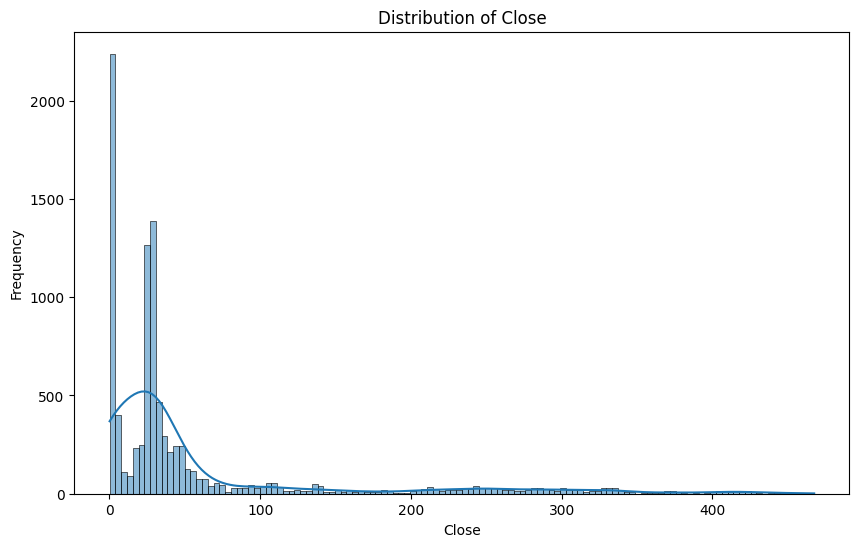

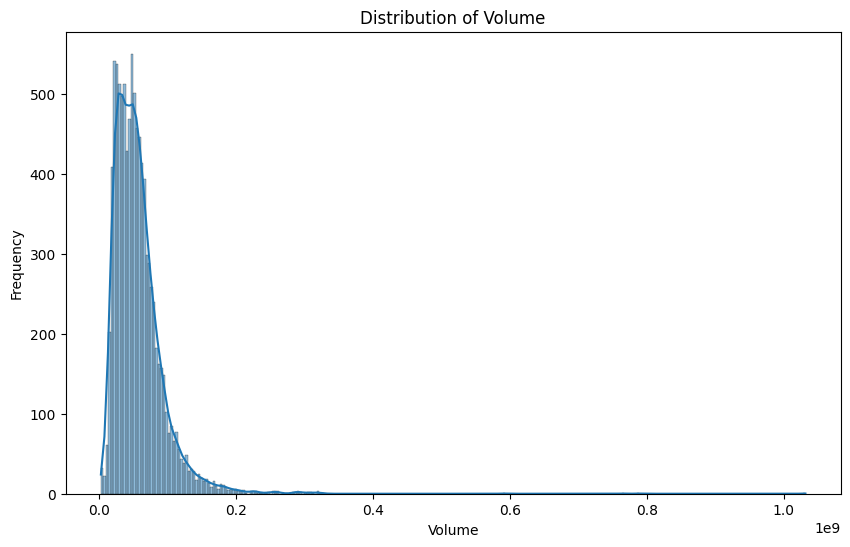

In [30]:
# Plot distributions
plot_distributions(df)

c:\Users\Darkles\10academy\10Academy-Kifiya-Week-1\env\Lib\site-packages\pyfolio\plotting.py:670: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.954%' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.



Start date,1986-03-13
End date,2024-07-30
Total months,460
,Backtest
Annual return,1.954%
Cumulative returns,110.179%
Annual volatility,12.106%
Sharpe ratio,0.22
Calmar ratio,0.04
Stability,0.82
Max drawdown,-51.285%


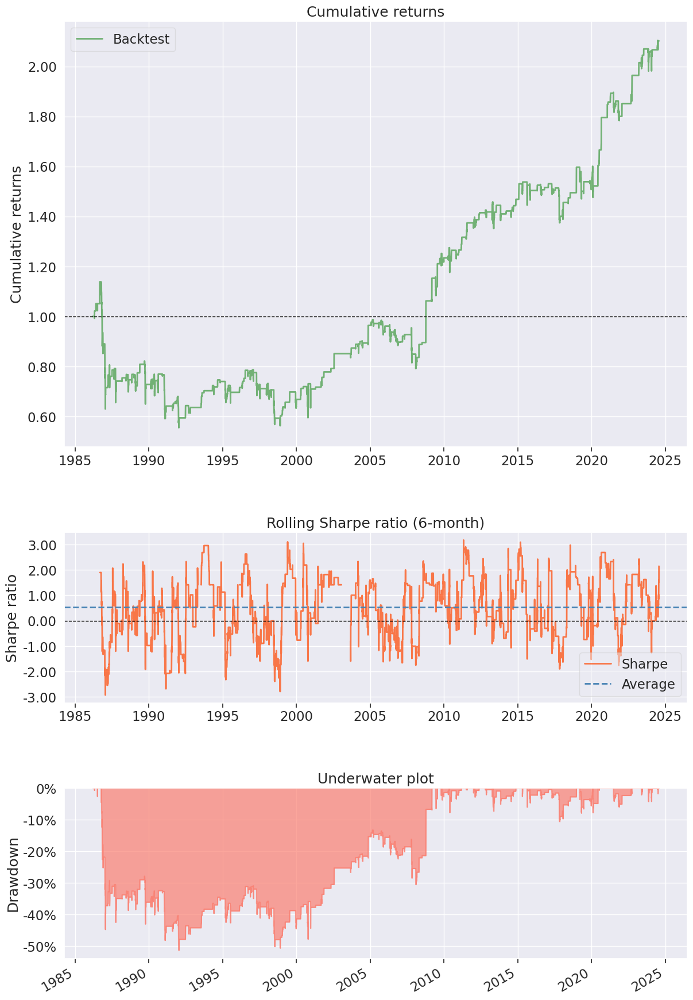

In [31]:
df['Signal'] = generate_signals(df)
df['Daily_Return'] = calculate_daily_return(df)
df['Strategy_Return'] = calculate_strategy_return(df)

create_performance_tear_sheet(df['Strategy_Return'])

In [32]:
# Calculate correlations
correlations = calculate_correlations(df, method="pearson")
correlations

,Date,Open,High,Low,Close,Adj Close,Volume,Dividends,Stock Splits,SMA,...,BB_middle,BB_lower,ATR,ADX,CCI,ROC,MACD_hist,Signal,Daily_Return,Strategy_Return
Date,1.000000,0.717296,0.717361,0.717355,0.717326,0.703645,-0.387487,0.064913,-0.028265,0.717967,...,0.717967,0.718182,0.669080,-0.077210,0.004604,-0.071995,-0.002579,0.003121,-0.020605,0.014471
Open,0.717296,1.000000,0.999946,0.999939,0.999871,0.998835,-0.345265,0.062717,-0.015429,0.999186,...,0.999186,0.998739,0.927478,0.004716,0.036272,-0.006234,-0.004259,-0.038726,-0.006915,0.007491
High,0.717361,0.999946,1.000000,0.999923,0.999936,0.998865,-0.344280,0.062537,-0.015390,0.999228,...,0.999228,0.998716,0.928891,0.004733,0.036516,-0.005899,-0.004051,-0.038840,-0.004027,0.007370
Low,0.717355,0.999939,0.999923,1.000000,0.999944,0.998940,-0.346409,0.062873,-0.015447,0.999066,...,0.999066,0.998677,0.926022,0.004622,0.038450,-0.004582,-0.001851,-0.039830,-0.003731,0.006909
Close,0.717326,0.999871,0.999936,0.999944,1.000000,0.998963,-0.345425,0.062683,-0.015344,0.999085,...,0.999085,0.998637,0.927355,0.004666,0.038566,-0.004082,-0.001511,-0.040043,-0.000387,0.006775
Adj Close,0.703645,0.998835,0.998865,0.998940,0.998963,1.000000,-0.345273,0.062650,-0.015094,0.998058,...,0.998058,0.997805,0.923302,0.004545,0.040809,-0.001956,-0.002128,-0.041436,0.000149,0.006300
Volume,-0.387487,-0.345265,-0.344280,-0.346409,-0.345425,-0.345273,1.000000,-0.026550,0.014379,-0.355351,...,-0.355351,-0.358461,-0.280756,0.118457,-0.105860,-0.050342,-0.022955,0.013433,-0.005739,0.003457
Dividends,0.064913,0.062717,0.062537,0.062873,0.062683,0.062650,-0.026550,1.000000,-0.001944,0.062167,...,0.062167,0.061367,0.056482,0.019674,-0.009524,-0.007757,0.011382,-0.000788,-0.042669,0.081799
Stock Splits,-0.028265,-0.015429,-0.015390,-0.015447,-0.015344,-0.015094,0.014379,-0.001944,1.000000,-0.015681,...,-0.015681,-0.015766,-0.014324,0.019942,0.013090,0.011139,0.003586,-0.038194,0.028944,-0.003326
SMA,0.717967,0.999186,0.999228,0.999066,0.999085,0.998058,-0.355351,0.062167,-0.015681,1.000000,...,1.000000,0.999599,0.931512,0.002208,0.017018,-0.023223,-0.038267,-0.028883,-0.008769,0.007850


In [33]:
# Detect outliers
outliers = detect_outliers(df, column="Close", method="iqr")
outliers

,Date,Open,High,Low,Close,Adj Close,Volume,Dividends,Stock Splits,SMA,...,BB_middle,BB_lower,ATR,ADX,CCI,ROC,MACD_hist,Signal,Daily_Return,Strategy_Return
Date,,,,,,,,,,,,,,,,,,,,,
2018-07-25,2018-07-25,107.959999,111.150002,107.599998,110.830002,103.822014,30702100,0.0,0.0,103.172001,...,103.172001,96.048851,1.876919,27.178829,148.367528,8.678170,0.652375,-1,0.029445,0.000000
2018-07-26,2018-07-26,110.739998,111.000000,109.500000,109.620003,102.688515,31372100,0.0,0.0,103.776001,...,103.776001,96.616989,1.849996,29.204352,137.215558,5.211633,0.626521,0,-0.010918,0.010918
2018-08-06,2018-08-06,108.120003,108.419998,107.559998,108.129997,101.292740,20265900,0.0,0.0,106.280001,...,106.280001,101.912325,1.903979,23.433279,72.959777,0.148186,-0.110883,0,0.000833,0.000000
2018-08-07,2018-08-07,108.559998,109.099998,108.169998,108.879997,101.995285,16080200,0.0,0.0,106.618001,...,106.618001,102.554690,1.837267,23.622133,90.976837,1.133191,-0.066893,0,0.006936,0.000000
2018-08-08,2018-08-08,109.330002,109.750000,108.760002,109.489998,102.566742,15487500,0.0,0.0,106.993501,...,106.993501,103.347412,1.776747,24.095481,109.187352,-1.209062,-0.012942,0,0.005603,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-07-24,2024-07-24,440.450012,441.480011,427.589996,428.899994,428.128326,26805800,0.0,0.0,451.887498,...,451.887498,431.895163,8.247001,22.965305,-168.458910,-8.010725,-3.698496,0,-0.035855,-0.000000
2024-07-25,2024-07-25,428.799988,429.799988,417.510010,418.399994,417.647217,29943800,0.0,0.0,450.199498,...,450.199498,425.449471,8.535785,24.541828,-206.147576,-7.983289,-4.603171,0,-0.024481,-0.000000
2024-07-26,2024-07-26,418.200012,428.920013,417.269989,425.269989,424.504852,23583800,0.0,0.0,448.820497,...,448.820497,421.841833,8.758231,26.020876,-157.912042,-6.235255,-4.507452,0,0.016420,0.000000


In [34]:
# Time-based aggregation
time_based_aggregation(df, time_column="Date", agg_column="Close", freq="ME", agg_func="mean")

,Date,Close
0,1986-03-31,0.096282
1,1986-04-30,0.102450
2,1986-05-31,0.111235
3,1986-06-30,0.111339
4,1986-07-31,0.102490
...,...,...
456,2024-03-31,416.789500
457,2024-04-30,413.263636
458,2024-05-31,417.537728
459,2024-06-30,438.342107
